# Colorization

## Remarks

Before running this notebook make sure you have already downloaded required images via scripts/generate_dataset.py and requirements.txt. In case you haven't, see the README.md file.

For this notebook we suggest you to generate a dataset, archive it, and load on your Google Drive. In further cells we described how to extract and use it.

## Data mounting and preparation

1.   Connect your Google Drive
2.   Prepare necessary folders. This notebook is an example of GAN model training, thus we use 'gan' as inner folders names.




In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!mkdir plots
!mkdir plots/gan
!mkdir plots/test
!mkdir models
!mkdir models/gan

!unzip ./drive/MyDrive/pictures.zip

Archive:  ./drive/MyDrive/pictures.zip
   creating: pictures/
   creating: pictures/val/
  inflating: pictures/val/image123.png  
  inflating: pictures/val/image36.png  
  inflating: pictures/val/image15.png  
  inflating: pictures/val/image146.png  
  inflating: pictures/val/image2.png  
  inflating: pictures/val/image68.png  
  inflating: pictures/val/image84.png  
  inflating: pictures/val/image93.png  
  inflating: pictures/val/image65.png  
  inflating: pictures/val/image130.png  
  inflating: pictures/val/image144.png  
  inflating: pictures/val/image16.png  
  inflating: pictures/val/image99.png  
  inflating: pictures/val/image61.png  
  inflating: pictures/val/image106.png  
  inflating: pictures/val/image199.png  
  inflating: pictures/val/image150.png  
  inflating: pictures/val/image14.png  
  inflating: pictures/val/image196.png  
  inflating: pictures/val/image111.png  
  inflating: pictures/val/image56.png  
  inflating: pictures/val/image190.png  
  inflating: pictures/

## Define functions for side usage

In [3]:
from functools import lru_cache
import cv2
import numpy as np
import polars as pl
import requests
import matplotlib.pyplot as plt
import json


def plot5pics(gray, color, output, epoch, path):
    """ Plot a grid of images.
        1st raw: 5 samples of gray images.
        2nd raw: 5 corresponding samples of model outputs.
        3rd raw: 5 corresponding samples of correctly colored images."""

    fig = plt.figure(figsize=(15, 8))
    for i in range(5):
        ax = plt.subplot(3, 5, i + 1)
        ax.imshow(gray[i].cpu(), cmap='gray')

        ax.axis("off")
        ax.set_title('Gray images')
        ax = plt.subplot(3, 5, i + 1 + 5)
        ax.imshow(output[i])
        ax.axis("off")
        ax.set_title(f'Epoch {epoch}')
        ax = plt.subplot(3, 5, i + 1 + 10)
        ax.imshow(color[i])
        ax.axis("off")
        ax.set_title('Ground truth')
    plt.plot()
    plt.savefig(path)



def save_model(model_gen, opt_gen, epoch, path: str, model_disc=None, opt_disc=None) -> None:
    """ Save model's and optimizer's state.
        Keep epoch number also for tracking and further training."""

    if model_disc is not None:
        torch.save({'model_generator': model_gen.state_dict(),
                            'model_discriminator': model_disc.state_dict(),
                            'optim_generative':opt_gen.state_dict(),
                            'optim_discriminative': opt_disc.state_dict(),
                            'epoch': epoch},
                            path)
    else:
        torch.save({'model_generator': model_gen.state_dict(),
                    'optim_generative':opt_gen.state_dict(),
                    'epoch': epoch},
                    path)

def plot_loss(losses_train_gen: list, losses_val_gen: list,
              losses_train_disc: list, losses_val_disc: list,
              path: str) -> None:
    """ Plot losses over epochs.
        Independently of model type train loss and validation loss will be plotted.
        Discriminator loss will be plotted if a passed list (losses_train_disc) is not empty
        (if it was updated during training). """

    plt.figure(figsize=(10, 5))
    plt.plot(losses_train_gen, label='Training generative loss')
    # label was changed after the notebook run (from "Validation loss" to "Validation generative loss")
    plt.plot(losses_val_gen, label='Validation generative loss')
    if len(losses_train_disc) != 0:
        plt.plot(losses_train_disc, label='Training discriminative loss')
        plt.plot(losses_val_disc, label='Validation discriminative loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.title('Loss over epochs')
    plt.legend()
    plt.savefig(path)


## Define functions for image convertions

In [4]:
import cv2
import numpy as np
import torch
from skimage.color import rgb2lab, lab2rgb


def rgb_to_gray(img):
    img = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    edges = cv2.Canny(img, 100, 200)
    edges = np.expand_dims(edges, axis=2)
    img = np.expand_dims(img, axis=2)
    img = np.append(edges, img, axis=2)
    return img


def lab_to_rgb(L, ab):
    L = (L + 1.) * 50.
    ab = ab * 110.
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)

def increase_color(image: np.ndarray, saturation: float) -> np.ndarray:
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    hsv[..., 1] = np.clip(hsv[..., 1] * saturation, 0, 255)
    enhanced_image = cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)
    return enhanced_image

## Create the Dataset class with \_\_len__ and \_\_getitem__

In [5]:
from torch.utils.data import Dataset
from torch import Tensor, max
from torchvision import transforms
import cv2
import os
import sys
import numpy as np
from skimage.color import rgb2lab
from PIL import Image


class PictureDataset(Dataset):
    def __init__(self, path=None, image_size=512, mode='train', convert_to='gray', amount=2000):
        amount = int(amount)
        if not path:
            project_path = '/content/'
            path = project_path + '/pictures'
            self.paths = [os.path.join(path, mode, img) for img in os.listdir(os.path.join(path, mode))]
            self.paths = self.paths[:amount]

        self.n = amount

        self.resize_transform = transforms.Compose([
            transforms.ToPILImage(),
            transforms.Resize((image_size,image_size)),
            transforms.ToTensor(),
        ])

        self.resize = transforms.Resize((image_size, image_size))

        self.convert_to = convert_to

    def __len__(self):
        return int(self.n)

    def __getitem__(self, idx):
        img_path = self.paths[idx]
        image = cv2.imread(img_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        if self.convert_to == 'gray':
            gray = rgb_to_gray(image)
            image, gray = self.resize_transform(image), self.resize_transform(gray)
            image = image/max(image)
            gray = gray/max(gray)
            return gray, image

        elif self.convert_to == 'lab':
            image = Image.fromarray(image)
            image = self.resize(image)
            image = np.array(image)
            lab = rgb2lab(image).astype("float32")
            lab = transforms.ToTensor()(lab)
            L = lab[[0], ...] / 50. - 1.
            ab = lab[[1, 2], ...] / 110.
            return L, ab

        else:
            raise Exception("Error occured. Cannot recognize convert type.")


## Define models' architectures

In [6]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision.transforms import Normalize

class CNN(torch.nn.Module):
    def __init__(self):
        super(CNN, self).__init__()
        self.norm = Normalize([0.5, 0.5, 0.5], [0.5, 0.5, 0.5])

        self.conv1 = nn.Conv2d(2, 32, kernel_size=3, padding=1)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=3, padding=1, stride=2)
        self.batchnorm1 = nn.BatchNorm2d(64)

        self.conv3 = nn.Conv2d(64, 128, kernel_size=3, padding=1, stride=2)
        self.conv4 = nn.Conv2d(128, 128, kernel_size=3, padding=1)
        self.batchnorm2 = nn.BatchNorm2d(128)

        self.conv5 = nn.Conv2d(128, 256, kernel_size=3, padding=1)
        self.batchnorm3 = nn.BatchNorm2d(256)

        # Upsampling layers to increase the spatial dimensions
        self.upsample1 = nn.Upsample(scale_factor=2, mode='nearest')
        self.conv6 = nn.Conv2d(256, 128, kernel_size=3, padding=1)
        self.batchnorm4 = nn.BatchNorm2d(128)

        self.upsample2 = nn.Upsample(scale_factor=2, mode='nearest')
        self.conv7 = nn.Conv2d(128, 64, kernel_size=3, padding=1)
        self.batchnorm5 = nn.BatchNorm2d(64)

        self.conv8 = nn.Conv2d(64, 32, kernel_size=3, padding=1)
        self.conv9 = nn.Conv2d(32, 3, kernel_size=3, padding='same')
        self.batchnorm6 = nn.BatchNorm2d(2)


    def forward(self, x):
        # Initial convolution layers with ReLU activations
        x = F.relu(self.conv1(x))
        x = F.relu(self.conv2(x))
        x = self.batchnorm1(x)

        x = F.relu(self.conv3(x))
        x = F.relu(self.conv4(x))
        x = self.batchnorm2(x)

        x = F.relu(self.conv5(x))
        x = self.batchnorm3(x)

        # Upsampling and convolution layers with ReLU activations
        x = self.upsample1(x)
        x = F.relu(self.conv6(x))
        x = self.batchnorm4(x)

        x = self.upsample2(x)
        x = F.relu(self.conv7(x))
        x = self.batchnorm5(x)

        x = F.relu(self.conv8(x))

        x = F.relu(self.conv9(x))
        x = self.norm(x)
        x = x - torch.min(x)
        x = x/torch.max(x)
        return x

def predict(model, gray):
    prepared = rgb_to_gray(gray)
    img = model(prepared)
    return img


def encoder(in_channels=0,out_channels=0,first=False):
    if first:
        return nn.Sequential(
            nn.Conv2d(in_channels,out_channels, kernel_size=4,stride=2,padding=1),
            nn.LeakyReLU(0.2)
        )
    else:
        return nn.Sequential(
            nn.Conv2d(in_channels,out_channels, kernel_size=4,stride=2,padding=1),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(0.2)
        )

def decoder(in_channels=0,out_channels=0,dropout = False):
    if dropout:
        return nn.Sequential(
            nn.ConvTranspose2d(in_channels,out_channels, kernel_size=4,stride=2,padding=1),
            nn.BatchNorm2d(out_channels),
            nn.Dropout2d(),
        )
    else:
        return nn.Sequential(
        nn.ConvTranspose2d(in_channels,out_channels, kernel_size=4,stride=2,padding=1),
        nn.BatchNorm2d(out_channels),
    )



class Generator(torch.nn.Module):
    def __init__(self):
        super(Generator, self).__init__()

        self.encoder1 = encoder(in_channels=1,   out_channels=64,first = True)
        self.encoder2 = encoder(in_channels=64,  out_channels=128)
        self.encoder3 = encoder(in_channels=128, out_channels=256)
        self.encoder4 = encoder(in_channels=256, out_channels=512)
        self.encoder5 = encoder(in_channels=512, out_channels=512)
        self.encoder6 = encoder(in_channels=512, out_channels=512)
        self.encoder7 = encoder(in_channels=512, out_channels=512)

        self.conv1 = nn.Sequential(
            nn.Conv2d(in_channels=512,out_channels=512,kernel_size=4,stride=2,padding=1),
            nn.ReLU()
        )
        self.decoder1 = decoder(in_channels=512, out_channels=512, dropout=True)
        self.decoder2 = decoder(in_channels=1024, out_channels=512, dropout=True)
        self.decoder3 = decoder(in_channels=1024, out_channels=512, dropout=True)
        self.decoder4 = decoder(in_channels=1024, out_channels=512)
        self.decoder5 = decoder(in_channels=1024, out_channels=256)
        self.decoder6 = decoder(in_channels=512, out_channels=128)
        self.decoder7 = decoder(in_channels=256, out_channels=64)

        self.conv2 = nn.Sequential(
            nn.ConvTranspose2d(in_channels = 128, out_channels = 2,kernel_size=4,stride=2,padding=1),
            nn.Tanh()
        )

    def encode(self,x):
        skips = []
        x = self.encoder1(x)
        skips.append(x)
        x = self.encoder2(x)
        skips.append(x)
        x = self.encoder3(x)
        skips.append(x)
        x = self.encoder4(x)
        skips.append(x)
        x = self.encoder5(x)
        skips.append(x)
        x = self.encoder6(x)
        skips.append(x)
        x = self.encoder7(x)
        skips.append(x)
        x = self.conv1(x)
        return x, skips

    def decode(self, x, skips):
        x = self.decoder1(x)
        x = F.relu(x)
        x = torch.cat([x,skips[6]],1)
        x = self.decoder2(x)
        x = torch.cat([x,skips[5]],1)
        x = F.relu(x)
        x = self.decoder3(x)
        x = torch.cat([x,skips[4]],1)
        x = F.relu(x)
        x = self.decoder4(x)
        x = torch.cat([x,skips[3]],1)
        x = F.relu(x)
        x = self.decoder5(x)
        x = torch.cat([x,skips[2]],1)
        x = F.relu(x)
        x = self.decoder6(x)
        x = torch.cat([x,skips[1]],1)
        x = F.relu(x)
        x = self.decoder7(x)
        x = torch.cat([x,skips[0]],1)
        x = F.relu(x)
        return x

    def forward(self,x):
        x, skips = self.encode(x)
        out = self.decode(x,skips)
        return self.conv2(out)


class CNNBlock(torch.nn.Module):
    def __init__(self, in_channels, out_channels, stride=2):
        super().__init__()
        self.conv = nn.Sequential(
            nn.Conv2d(in_channels=in_channels,out_channels=out_channels, kernel_size=4, stride=stride, padding=1),
            nn.BatchNorm2d(out_channels),
            nn.LeakyReLU(0.2),
        )
    def forward(self, x):
        return self.conv(x)


class Discriminator(torch.nn.Module):
    def __init__(self, in_channels=3, dim=64):
        super(Discriminator,self).__init__()
        dims = [64, 128, 256, 512]
        self.first = nn.Sequential(
            nn.Conv2d(3,dims[0], kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
        )
        layers = []
        in_channels = dims[0]
        for dim in dims[1:]:
            layers.append(
                CNNBlock(in_channels, dim, stride=1 if dim == dims[len(dims)-int(1)] else 2),
            )
            in_channels = dim
        layers.append(
            nn.Conv2d(512, 1, kernel_size=4, stride=1, padding=1)
        )
        self.model = nn.Sequential(*layers)

    def forward(self, x, y):
        x = torch.cat([x,y], dim=1)
        x = self.first(x)
        return self.model(x)

## Train and Validation loops

In [7]:
import numpy as np
from tqdm import tqdm
import torch
from matplotlib import pyplot as plt

def train_one_epoch(
    loader,
    model_generator,
    optim_gen,
    loss_fn_gen,
    model_discriminator=None,
    optim_disc=None,
    loss_fn_disc=None,
    model_name='cnn',
    epoch_num=-1,
    device='cpu',
    L1_LAMBDA=100,
    ):

    loop = tqdm(enumerate(loader), total=len(loader), desc=f"Epoch {epoch_num}: train", leave=True)
    model_generator.train()

    generative_loss_sum = 0.0
    discriminative_loss_sum = 0.0

    # train loop
    for i, batch in loop:
        gray, colored = batch
        colored = colored.to(device)
        gray = gray.to(device)

        # forward pass
        outputs = model_generator(gray)

        if model_name=='gan':
            # discriminator: comparison with actual image and loss calculation
            D_real = model_discriminator(gray, colored)
            D_fake = model_discriminator(gray, outputs.detach())

            D_real_l = loss_fn_disc(D_real, torch.ones_like(D_real))
            D_fake_l = loss_fn_disc(D_fake, torch.zeros_like(D_fake))
            discriminative_loss = D_real_l + D_fake_l

            optim_disc.zero_grad()
            discriminative_loss.backward()
            optim_disc.step()
            discriminative_loss_sum += discriminative_loss.item()


        # generator: loss calculation
        generative_loss = loss_fn_gen(outputs, colored)
        if model_name == 'gan':
            D_fake = model_discriminator(gray, outputs)
            G_fake_l = loss_fn_gen(D_fake, torch.ones_like(D_fake))
            loss_scaled = generative_loss *L1_LAMBDA
            generative_loss = G_fake_l + loss_scaled

        optim_gen.zero_grad()
        generative_loss.backward()
        optim_gen.step()
        generative_loss_sum += generative_loss.item()

        loop.set_postfix({"loss": float(generative_loss)})

    if model_name == 'cnn':
        print('Train loss:', float(generative_loss_sum) / (i+1))
    else:
        print('Generator loss: ', generative_loss_sum/(i+1), '. Discriminator loss: ', discriminative_loss_sum/(i+1), sep='')

    return generative_loss_sum / (i+1), discriminative_loss_sum / (i+1)




def val_one_epoch(
    model_generator,
    loader,
    loss_fn_gen,
    model_name='cnn',
    model_discriminator=None,
    loss_fn_disc=None,
    plots_path="plots/",
    epoch_num=-1,
    device='cpu',
    L1_LAMBDA = 100,
):

    loop = tqdm(enumerate(loader, 1), total=len(loader), desc=f"Epoch {epoch_num}: val", leave=True)

    gen_loss_sum = 0.0
    disc_loss_sum = 0.0

    # keep images to plot them
    fake_imgs = []
    real_imgs = []
    gray_imgs = []

    with torch.no_grad():
        model_generator.eval()
        model_discriminator.eval()


        # save 1 picture each batch
        for i, batch in loop:
            gray, colored = batch
            colored = colored.to(device)
            gray = gray.to(device)

            # forward pass
            outputs = model_generator(gray)

            if model_name == 'gan':
                D_real = model_discriminator(gray, colored)
                D_fake = model_discriminator(gray, outputs.detach())

                D_real_l = loss_fn_disc(D_real, torch.ones_like(D_real))
                D_fake_l = loss_fn_disc(D_fake, torch.zeros_like(D_fake))
                discriminative_loss = D_real_l + D_fake_l

                disc_loss_sum += discriminative_loss.item()

            # loss calculation
            generative_loss = loss_fn_gen(outputs, colored)
            if model_name == 'gan':
                D_fake = model_discriminator(gray, outputs)
                G_fake_l = loss_fn_gen(D_fake, torch.ones_like(D_fake))
                loss_scaled = generative_loss * L1_LAMBDA
                generative_loss = G_fake_l + loss_scaled
            gen_loss_sum += generative_loss.item()

            # Error was found
            # postfix value was changed after the notebook tun: from gen_loss_sum to generative_loss
            loop.set_postfix({"loss": float(generative_loss)})

            # picture saving
            if model_name == 'cnn':
                gray_imgs.append(gray[0][1].squeeze().cpu())
                real_imgs.append(colored[0].permute(1, 2, 0).cpu())
                fake_imgs.append(outputs[0].permute(1, 2, 0).cpu())
            else:
                gray_imgs.append(gray[0].cpu()[0])
                real_imgs.append(lab_to_rgb(gray, colored)[0])
                fake_imgs.append(lab_to_rgb(gray, outputs.detach())[0])

    # save model result to compare it over epochs
    path = f'{plots_path}visual_progress_epoch_{epoch_num}.png'
    plot5pics(gray_imgs, real_imgs, fake_imgs, epoch_num, path)

    print('Val loss:',float(gen_loss_sum) / (i+1))
    return gen_loss_sum / (i+1), disc_loss_sum / (i+1)



def train(
    train_dataloader,
    val_dataloader,
    model_generative,
    optim_generative,
    loss_fn_generative,
    model_disc=None,
    optim_disc=None,
    loss_fn_disk=None,
    model_name='cnn',
    epochs=10,
    ckpt_path="models/best.pt",
    plots_path="plots/",
    device='cpu',
    save_freq=2,
):
    # check for any errors
    if model_name not in ['gan', 'cnn']:
        raise Exception("Error. Unsupportabble type of model (model_name).")

    # keep previous best loss to receive the 'best.pth' model with the least val loss
    prev_best = float("inf")

    # save losses for plotting
    losses_train_gen = []
    losses_train_disc = []
    losses_val_gen = []
    losses_val_disc = []

    for epoch in range(epochs):
        # train
        generative_loss, disc_loss = train_one_epoch(
            train_dataloader,
            model_generative,
            optim_generative,
            loss_fn_generative,
            model_disc,
            optim_disc,
            loss_fn_disk,
            model_name=model_name,
            epoch_num=epoch,
            device=device,
            )

        if model_name == 'gan':
            losses_train_disc.append(disc_loss)
        losses_train_gen.append(generative_loss)

        # validate
        generative_loss, disc_loss = val_one_epoch(
            model_generative,
            val_dataloader,
            loss_fn_generative,
            model_name=model_name,
            model_discriminator=model_disc,
            loss_fn_disc=loss_fn_disk,
            plots_path=plots_path,
            epoch_num=epoch,
            device=device,
            )
        if model_name == 'gan':
            losses_val_disc.append(disc_loss)
        losses_val_gen.append(generative_loss)

        # model and model's output saving because intermediate results of Colorization
        # might be better than final
        if epoch % save_freq == 0:
            filename = ckpt_path+f'model{epoch}.pth'
            if model_name == 'cnn':
                save_model(model_generative, optim_generative, epoch, filename)
            else:
                save_model(model_generative, optim_generative, epoch, filename, model_disc, optim_disc)


        if generative_loss < prev_best:
            prev_best = generative_loss
            filename = ckpt_path + 'best.pth'

            if model_name == 'cnn':
                save_model(model_generative, optim_generative, epoch, filename)
            else:
                save_model(model_generative, optim_generative, epoch, filename, model_disc, optim_disc)

    # plot losses over epochs
    filename = plots_path + 'train_val_loss.png'
    plot_loss(losses_train_gen, losses_val_gen, losses_train_disc, losses_val_disc, filename)


## Main pipeline

Epoch 0: train: 100%|██████████| 450/450 [07:19<00:00,  1.02it/s, loss=21.5]


Generator loss: 16.713781596289742. Discriminator loss: 0.5902661466681295


Epoch 0: val: 100%|██████████| 50/50 [00:48<00:00,  1.02it/s, loss=761]


Val loss: 14.927184609805837


Epoch 1: train: 100%|██████████| 450/450 [07:19<00:00,  1.02it/s, loss=10.7]


Generator loss: 13.097973228030735. Discriminator loss: 1.3287650330199137


Epoch 1: val: 100%|██████████| 50/50 [00:47<00:00,  1.06it/s, loss=645]


Val loss: 12.646716641444787


Epoch 2: train: 100%|██████████| 450/450 [07:19<00:00,  1.02it/s, loss=14.6]


Generator loss: 13.689422618018256. Discriminator loss: 0.7635412978629271


Epoch 2: val: 100%|██████████| 50/50 [00:47<00:00,  1.06it/s, loss=644]


Val loss: 12.61772907481474


Epoch 3: train: 100%|██████████| 450/450 [07:17<00:00,  1.03it/s, loss=17.4]


Generator loss: 13.872083713743422. Discriminator loss: 0.6985531037549177


Epoch 3: val: 100%|██████████| 50/50 [00:48<00:00,  1.03it/s, loss=587]


Val loss: 11.509583791097006


Epoch 4: train: 100%|██████████| 450/450 [07:20<00:00,  1.02it/s, loss=16.6]


Generator loss: 15.19141563627455. Discriminator loss: 0.5903805774781439


Epoch 4: val: 100%|██████████| 50/50 [00:47<00:00,  1.06it/s, loss=743]


Val loss: 14.568311261195763


Epoch 5: train: 100%|██████████| 450/450 [07:42<00:00,  1.03s/it, loss=18.2]


Generator loss: 15.038103309207493. Discriminator loss: 0.6455407465497652


Epoch 5: val: 100%|██████████| 50/50 [00:46<00:00,  1.08it/s, loss=1.08e+3]


Val loss: 21.094293930951288


Epoch 6: train: 100%|██████████| 450/450 [07:18<00:00,  1.03it/s, loss=13.4]


Generator loss: 16.544994254642063. Discriminator loss: 0.5767745610243744


Epoch 6: val: 100%|██████████| 50/50 [00:47<00:00,  1.06it/s, loss=567]


Val loss: 11.111631823521034


Epoch 7: train: 100%|██████████| 450/450 [07:16<00:00,  1.03it/s, loss=12.7]


Generator loss: 15.593374880684747. Discriminator loss: 0.6007724875211715


Epoch 7: val: 100%|██████████| 50/50 [00:53<00:00,  1.07s/it, loss=584]


Val loss: 11.448625527176203


Epoch 8: train: 100%|██████████| 450/450 [07:37<00:00,  1.02s/it, loss=22.1]


Generator loss: 16.261329726113214. Discriminator loss: 0.5557977063664131


Epoch 8: val: 100%|██████████| 50/50 [00:54<00:00,  1.09s/it, loss=615]


Val loss: 12.064962592779422


Epoch 9: train: 100%|██████████| 450/450 [07:51<00:00,  1.05s/it, loss=14.5]


Generator loss: 16.786318740844727. Discriminator loss: 0.4873745561556684


Epoch 9: val: 100%|██████████| 50/50 [00:46<00:00,  1.09it/s, loss=583]


Val loss: 11.424291853811226


Epoch 10: train: 100%|██████████| 450/450 [07:18<00:00,  1.03it/s, loss=14.8]


Generator loss: 17.008924441867403. Discriminator loss: 0.4711370780567328


Epoch 10: val: 100%|██████████| 50/50 [00:48<00:00,  1.04it/s, loss=692]


Val loss: 13.560052890403599


Epoch 11: train: 100%|██████████| 450/450 [07:17<00:00,  1.03it/s, loss=21]


Generator loss: 16.57535756217109. Discriminator loss: 0.4413057314604521


Epoch 11: val: 100%|██████████| 50/50 [00:46<00:00,  1.07it/s, loss=635]


Val loss: 12.453898523368087


Epoch 12: train: 100%|██████████| 450/450 [07:18<00:00,  1.03it/s, loss=25]


Generator loss: 16.4361172358195. Discriminator loss: 0.4749089393723342


Epoch 12: val: 100%|██████████| 50/50 [00:46<00:00,  1.07it/s, loss=1.31e+3]


Val loss: 25.751060261445886


Epoch 13: train: 100%|██████████| 450/450 [07:17<00:00,  1.03it/s, loss=11.1]


Generator loss: 17.995364943610298. Discriminator loss: 0.38475559851361646


Epoch 13: val: 100%|██████████| 50/50 [00:47<00:00,  1.06it/s, loss=748]


Val loss: 14.66114117117489


Epoch 14: train: 100%|██████████| 450/450 [07:16<00:00,  1.03it/s, loss=13.3]


Generator loss: 18.079407702551947. Discriminator loss: 0.4451457127928734


Epoch 14: val: 100%|██████████| 50/50 [00:46<00:00,  1.07it/s, loss=798]


Val loss: 15.64641772999483


Epoch 15: train: 100%|██████████| 450/450 [07:17<00:00,  1.03it/s, loss=18.3]


Generator loss: 15.399603678385416. Discriminator loss: 0.5036157576822572


Epoch 15: val: 100%|██████████| 50/50 [00:46<00:00,  1.08it/s, loss=693]


Val loss: 13.593112010581821


Epoch 16: train: 100%|██████████| 450/450 [07:16<00:00,  1.03it/s, loss=17.3]


Generator loss: 17.196612244711982. Discriminator loss: 0.38029121318521597


Epoch 16: val: 100%|██████████| 50/50 [00:48<00:00,  1.04it/s, loss=1.42e+3]


Val loss: 27.868900037279317


Epoch 17: train: 100%|██████████| 450/450 [07:17<00:00,  1.03it/s, loss=19.1]


Generator loss: 16.143698365953234. Discriminator loss: 0.464794374058644


Epoch 17: val: 100%|██████████| 50/50 [00:46<00:00,  1.07it/s, loss=548]


Val loss: 10.754503287521063


Epoch 18: train: 100%|██████████| 450/450 [07:15<00:00,  1.03it/s, loss=12.7]


Generator loss: 18.61789724773831. Discriminator loss: 0.3714502669053359


Epoch 18: val: 100%|██████████| 50/50 [00:47<00:00,  1.05it/s, loss=765]


Val loss: 14.993400424134498


Epoch 19: train: 100%|██████████| 450/450 [07:17<00:00,  1.03it/s, loss=18]


Generator loss: 18.595399089389378. Discriminator loss: 0.29492506079582703


Epoch 19: val: 100%|██████████| 50/50 [00:46<00:00,  1.08it/s, loss=752]


Val loss: 14.74769255694221


Epoch 20: train: 100%|██████████| 450/450 [07:22<00:00,  1.02it/s, loss=20]


Generator loss: 15.618099314371745. Discriminator loss: 0.4585225136929916


Epoch 20: val: 100%|██████████| 50/50 [00:48<00:00,  1.03it/s, loss=808]


Val loss: 15.842553101333918


Epoch 21: train: 100%|██████████| 450/450 [07:19<00:00,  1.02it/s, loss=11.6]


Generator loss: 15.093702083163791. Discriminator loss: 0.47041716140384476


Epoch 21: val: 100%|██████████| 50/50 [00:46<00:00,  1.07it/s, loss=649]


Val loss: 12.715691267275343


Epoch 22: train: 100%|██████████| 450/450 [07:16<00:00,  1.03it/s, loss=14.1]


Generator loss: 14.231499766243829. Discriminator loss: 0.532409029164248


Epoch 22: val: 100%|██████████| 50/50 [00:46<00:00,  1.07it/s, loss=460]


Val loss: 9.013867004244934


Epoch 23: train: 100%|██████████| 450/450 [07:15<00:00,  1.03it/s, loss=9.17]


Generator loss: 14.3049422899882. Discriminator loss: 0.4427525884451138


Epoch 23: val: 100%|██████████| 50/50 [00:45<00:00,  1.10it/s, loss=520]


Val loss: 10.197019913617302


Epoch 24: train: 100%|██████████| 450/450 [07:19<00:00,  1.02it/s, loss=11.8]


Generator loss: 14.773588781356812. Discriminator loss: 0.6198387095663282


Epoch 24: val: 100%|██████████| 50/50 [00:49<00:00,  1.01it/s, loss=916]


Val loss: 17.96122221853219


Epoch 25: train:  53%|█████▎    | 239/450 [03:54<03:26,  1.02it/s, loss=13]


KeyboardInterrupt: 

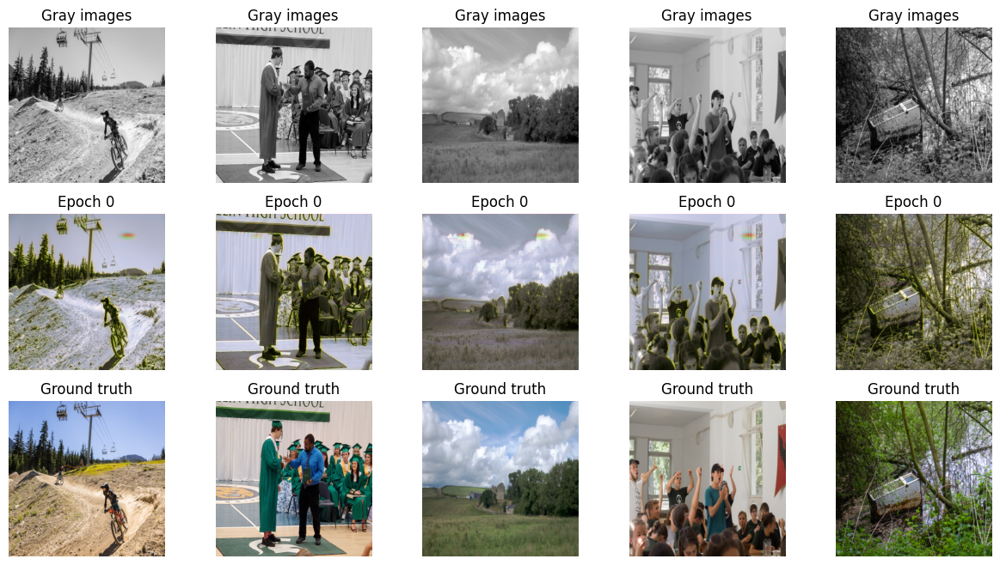

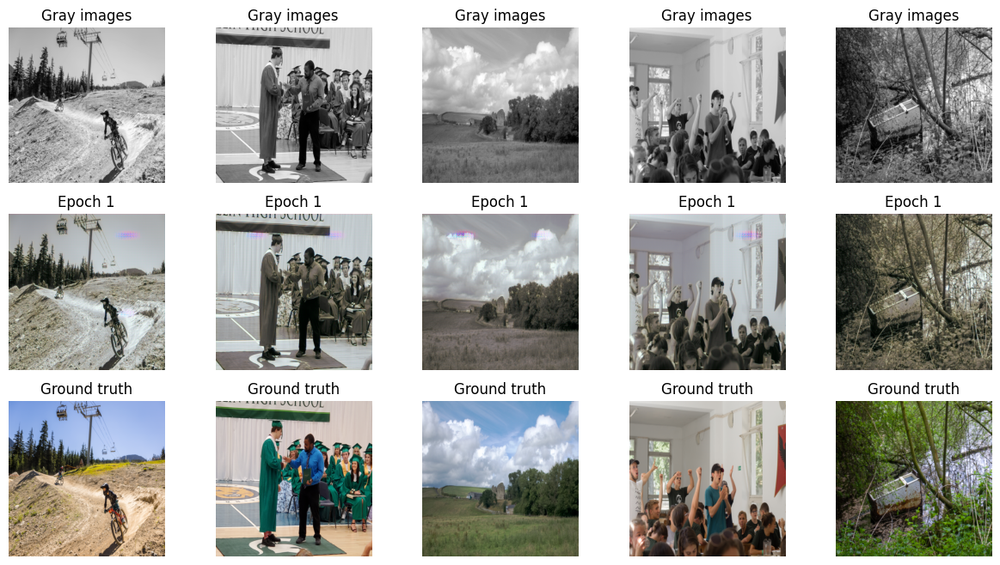

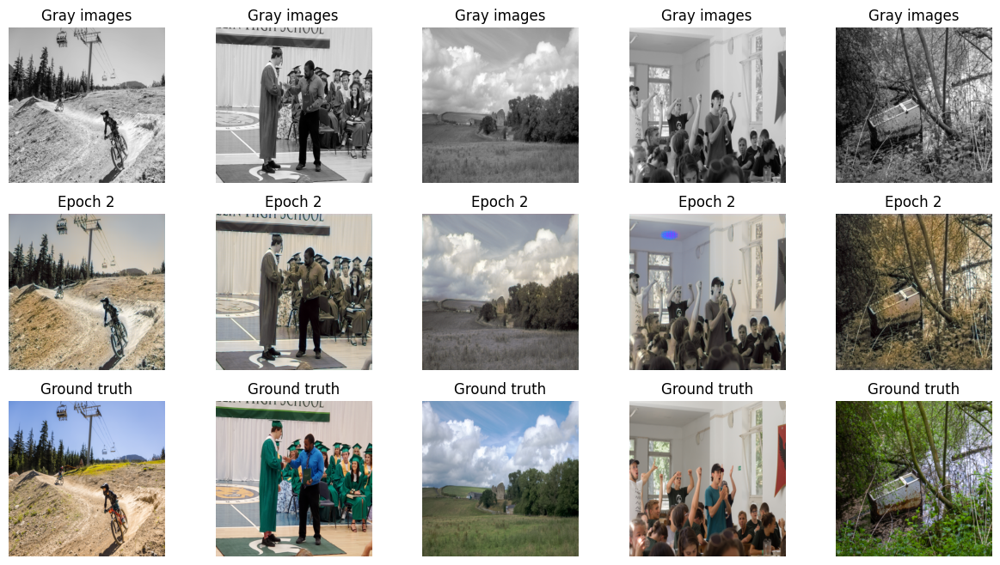

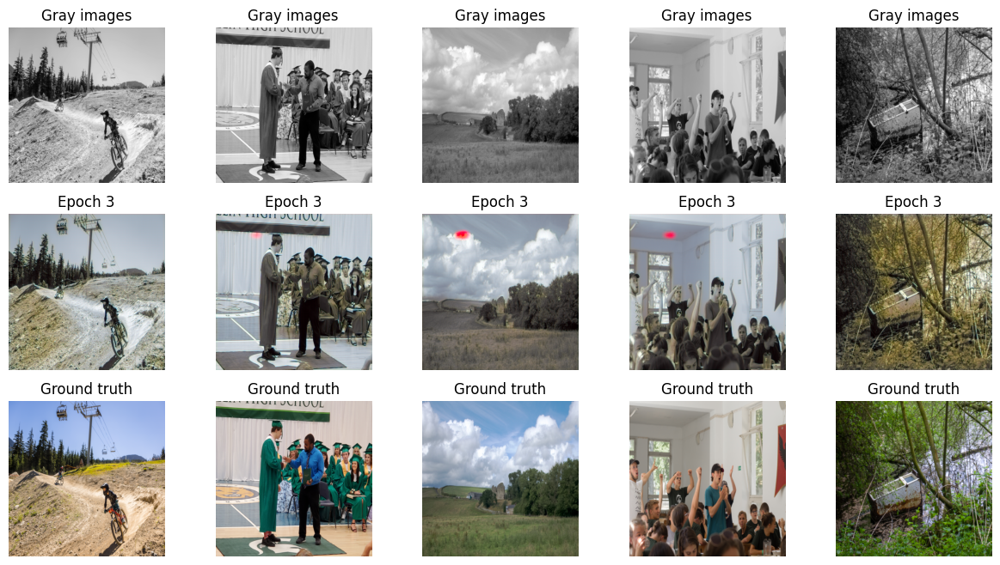

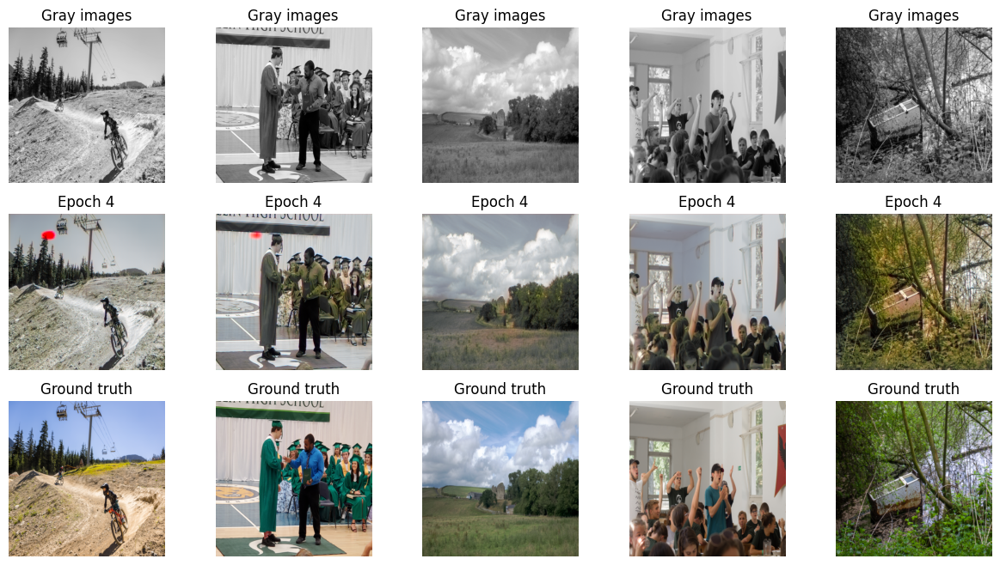

...

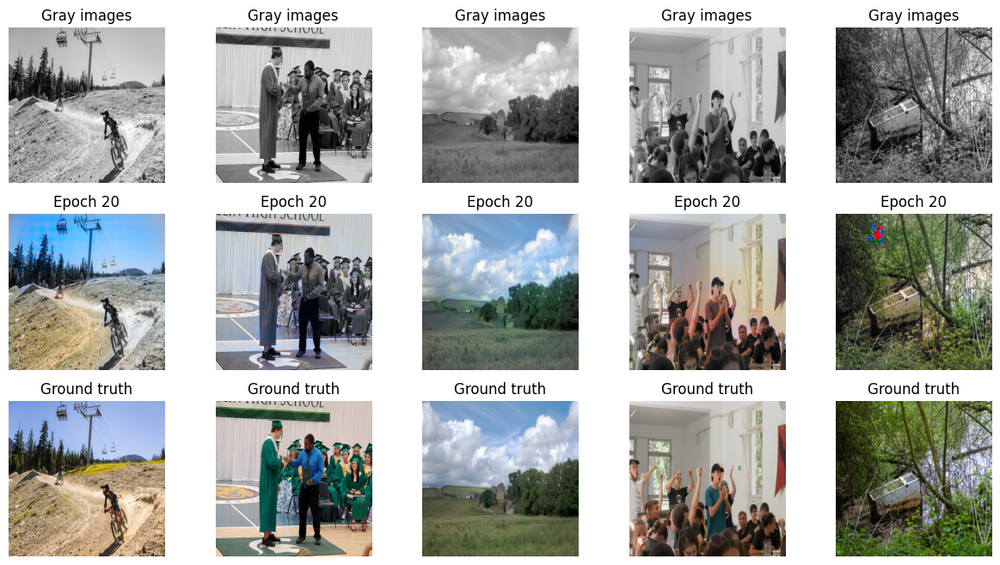

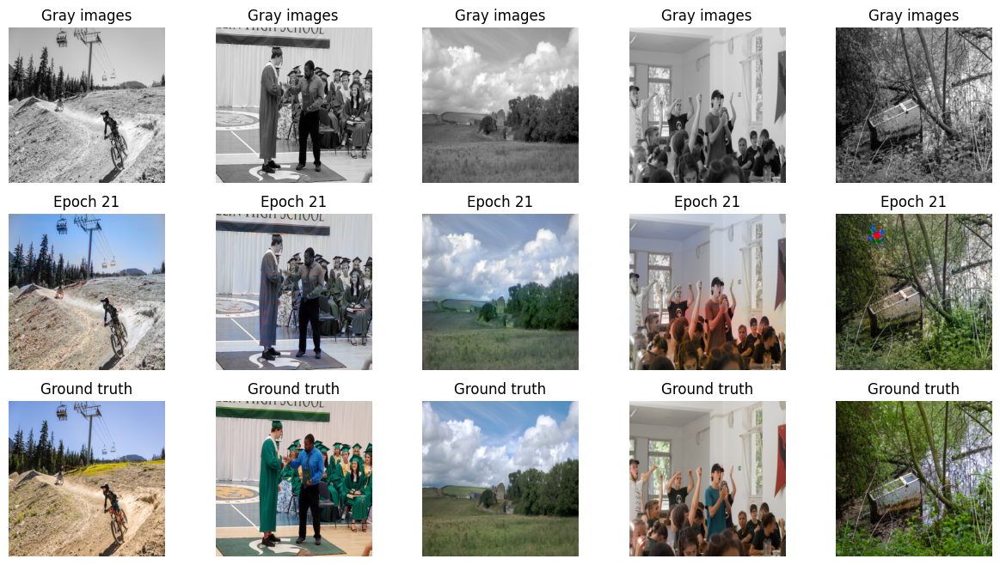

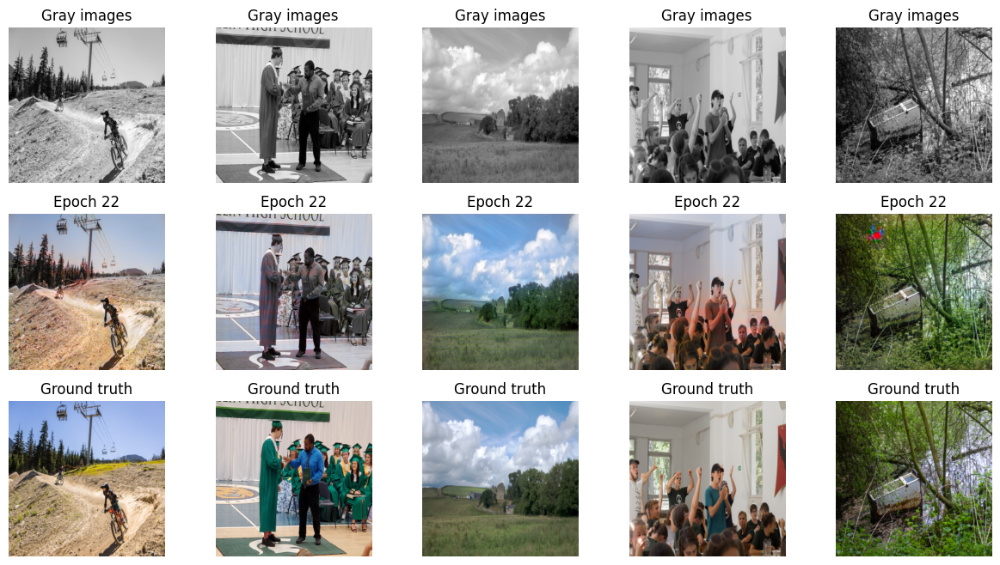

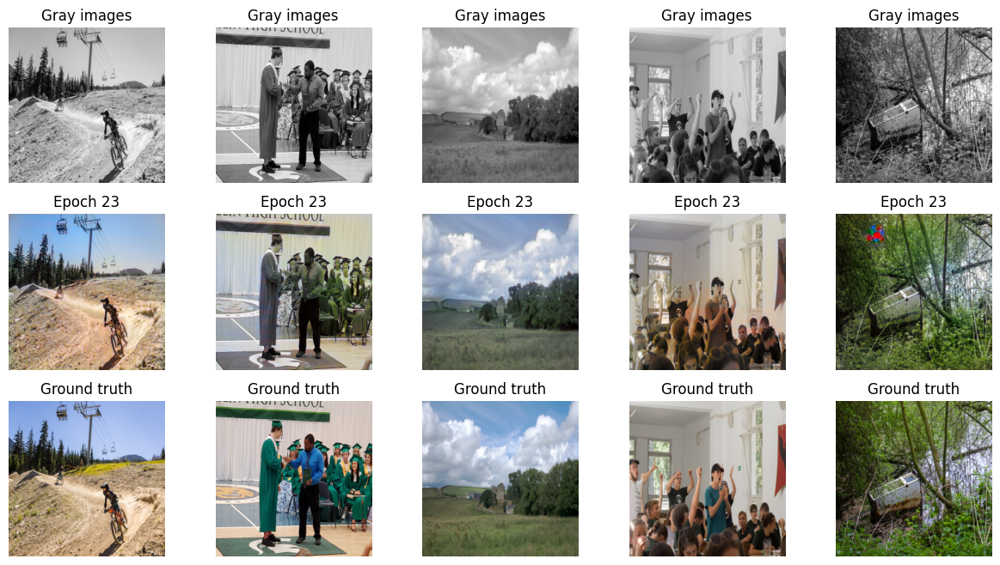

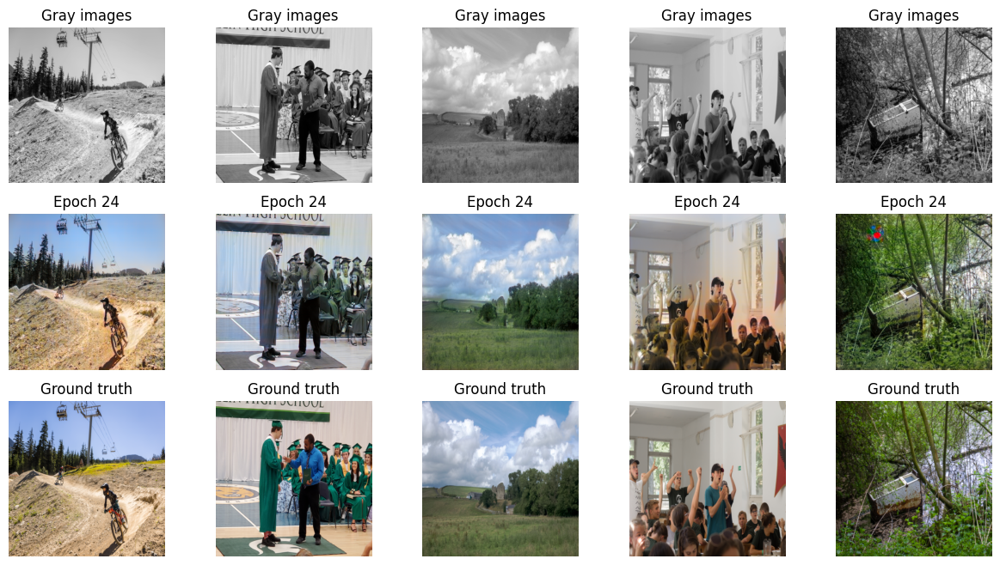

In [8]:
from torch.utils.data import DataLoader
import torch
import torch.optim as optim
import os
import sys
import warnings
warnings.filterwarnings('ignore')

config = {
    "epochs": 40,
    "batch_size": 4,
    "pic_size": 1024,
    "pictures_num": 2000,
    "train_val_split": 0.1,
    "model": "gan",
    "run": 0
}

epochs = config['epochs']
batch_size = config['batch_size']
pic_size = config['pic_size']
train_val_split = config['train_val_split']
model_name = config['model']
pictures_num = config['pictures_num']

ckpt_path = f'./models/{model_name}/'
plots_path = f'./plots/{model_name}/'

if model_name == 'cnn':
    convert_to = 'gray'
elif model_name == 'gan':
    convert_to = 'lab'
else:
    raise Exception(f"Error. Unsupportable type of model (model_name: {model_name}).")
device = 'cuda' if torch.cuda.is_available() else 'cpu'


train_dataset = PictureDataset(mode='train', convert_to=convert_to, amount=pictures_num*(1-train_val_split))
val_dataset = PictureDataset(mode='val', convert_to=convert_to, amount=pictures_num*train_val_split)
train_dataloader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
val_dataloader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False)

if model_name == 'cnn':
    model = CNN().to(device)
    optimizer = optim.Adam(model.parameters(), lr=0.001)
    loss_fn = torch.nn.MSELoss()

    train(train_dataloader, val_dataloader,
          model, optimizer, loss_fn,
          model_name=model_name, epochs=epochs, ckpt_path=ckpt_path, plots_path=plots_path, device=device, save_freq=2)

else:
    model_discriminator = Discriminator(in_channels=3).to(device)
    model_generator = Generator().to(device)
    optim_disc = optim.Adam(model_discriminator.parameters(), lr=2e-4, betas=(0.5, 0.999))
    optim_gen = optim.Adam(model_generator.parameters(), lr=2e-4, betas=(0.5, 0.999))
    loss_fn_gen = torch.nn.L1Loss()
    loss_fn_disc = torch.nn.BCEWithLogitsLoss()

    train(train_dataloader, val_dataloader,
          model_generator, optim_gen, loss_fn_gen,
          model_discriminator, optim_disc, loss_fn_disc,
          model_name, epochs, ckpt_path, plots_path, device, 1)


## Test.

Lets see how the model deals with some other pictures from the Validation dataset

In [9]:
!mkdir ./plots/test

In [13]:
# BE CAREFUL
# This cell suits only for GAN models
# To test CNN model get rid of model_generator

best = torch.load('./models/gan/best.pth')

model_discriminator = Discriminator().to(device)
model_discriminator.load_state_dict(best['model_discriminator'])

model_generator = Generator().to(device)
model_generator.load_state_dict(best['model_generator'])

test_dataloader = DataLoader(val_dataset, batch_size=1, shuffle=False)
loop = tqdm(enumerate(test_dataloader, 1), total=len(test_dataloader))

with torch.no_grad():
    model_generator.eval()
    model_discriminator.eval()

    for i, batch in loop:
        # 1 image per batch
        gray, colored = batch
        colored = colored.to(device)
        gray = gray.to(device)

        outputs = model_generator(gray)

        if model_name == 'cnn':
            gray = gray[0][1].squeeze().cpu()
            real = colored[0].permute(1, 2, 0).cpu()
            fake = outputs[0].permute(1, 2, 0).cpu()
        else:
            gray = gray[0].cpu()[0]
            real = lab_to_rgb(gray, colored)[0]
            fake = lab_to_rgb(gray, outputs.detach())[0]

        # val_dataset contains 200 images, all of them are loaded by default
        # plot each 10th image result
        if i % 20 == 0:
            plot5pics([gray], [real], [fake], -1, f'./plots/test/image{i}.png')



  0%|          | 0/200 [00:00<?, ?it/s]


RuntimeError: Expected all tensors to be on the same device, but found at least two devices, cpu and cuda:0! (when checking argument for argument tensors in method wrapper_CUDA_cat)